In [8]:
#%matplotlib notebook
import sys
sys.path.insert(0, '../../flygenvectors/')

import os
import numpy as np
from glob import glob
import scipy.io as sio
from scipy import sparse, signal

from sklearn.decomposition import PCA, FastICA
# from skimage.restoration import denoise_tv_chambolle

import matplotlib.pyplot as plt
from matplotlib import axes, gridspec, colors

import matplotlib.pylab as pl
from scipy.stats import zscore
import data as dataUtils
import plotting
import flygenvectors.ssmutils as utils

from sklearn.cluster import AgglomerativeClustering
from sklearn.linear_model import Ridge, LinearRegression
from sklearn.metrics import r2_score

from IPython.display import set_matplotlib_formats
set_matplotlib_formats('png', 'pdf')

import seaborn as sns
sns.set_style("white")
sns.set_context("talk")

### load data

In [9]:
main_dir = '/Users/evan/Dropbox/_AxelLab/__flygenvectors/dataShare/_runFeedRun/'
main_fig_dir = '/Users/evan/Dropbox/_AxelLab/__flygenvectors/figures/'
# main_dir = '/Volumes/data1/_flygenvectors_dataShare/_main/_sparseLines/'
# main_fig_dir = '/Volumes/data1/figsAndMovies/figures/'

exp_date = '2019_04_24' 
fly_num = 'fly3'

data_dict = dataUtils.load_timeseries_simple(exp_date,fly_num,main_dir)
expt_id = exp_date+'_'+fly_num
fig_folder = main_fig_dir+expt_id+'/'
clustfig_folder = fig_folder+'clusters/'
if not os.path.exists(fig_folder):
    #os.mkdir(main_fig_dir+expt_id)
    os.mkdir(fig_folder)
    os.mkdir(clustfig_folder)

### pre-processing

In [10]:
# normalize dFF by noise variance (not currently used below)
dFFn = data_dict['dFF'].copy()
sn = np.zeros(dFFn.shape[0])
for i in range(dFFn.shape[0]):
    sn[i] = dataUtils.estimate_noise_variance(dFFn[i,:])
    dFFn[i,:] = dFFn[i,:]/sn[i]
data_dict['dFFn'] = dFFn

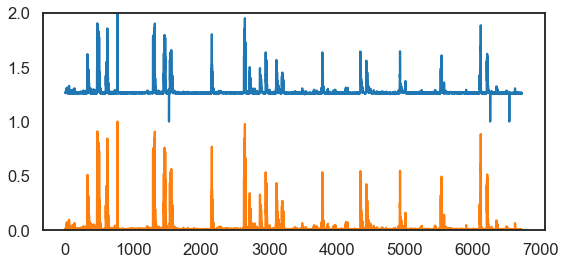

In [11]:
# preprocess behavior in TWO pieces 
# (goal is to squish upper range so single points don't dominate, 
# and truncate lower range so baseline is approximately zero throughout)
behavior = np.squeeze(data_dict['ball']).copy()
# trialFlag = np.squeeze(data_dict['trialFlag'])

# plt.figure(figsize=(9,4))
# plt.plot(1+behavior/behavior.max())

# # on a ball
# behIdx = np.logical_or(trialFlag==1,trialFlag==3)
# behTmp = behavior[behIdx].copy()
# behavior[behIdx] = plotting.trim_dynamic_range(behTmp, 0.6, 0.999)

# # flailing/feeding
# behIdx = trialFlag==2
# behTmp = behavior[behIdx].copy()
# behavior[behIdx] = plotting.trim_dynamic_range(behTmp, 0.1, 0.9999)

# plt.plot(behavior)
# plt.ylim((0,2))
# plt.show()

# data_dict['ball'] = behavior

plt.figure(figsize=(9,4))
plt.plot(1+behavior/behavior.max())

# flailing/feeding
behavior = plotting.trim_dynamic_range(behavior, 0.1, 0.9999)

plt.plot(behavior)
plt.ylim((0,2))
plt.show()

data_dict['ball'] = behavior

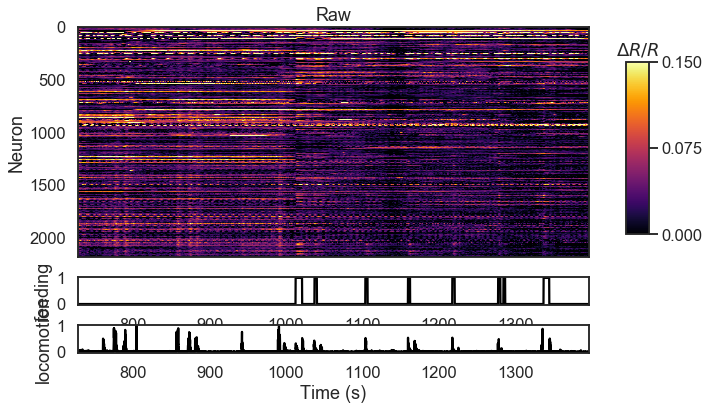

In [12]:
# visualize raw data
# Note: optional second arg of show_raster_with_behav is color range,
# accepts (min,max) tuple, defaults to (0,0.4), also accepts 'auto'

dt = data_dict['time'][1]-data_dict['time'][0]
tPl = data_dict['time'][0]+np.linspace(0,dt*len(data_dict['time']),len(data_dict['time']))
data_dict['tPl'] = tPl
plotting.show_raster_with_behav(data_dict, (0,0.15), include_feeding=True)
plt.savefig(fig_folder + exp_date + '_' + fly_num +'_raster.pdf',transparent=True, bbox_inches='tight')

In [13]:
# agglomerative clustering with variable cluster number
cluster = AgglomerativeClustering(
    n_clusters=None, affinity='cosine', 
    linkage='complete', distance_threshold=0.5)  #0.8
cluster.fit_predict(data_dict['dFF'])  
nClust = len(np.unique(cluster.labels_))
print('found '+str(nClust)+' clusters')

found 51 clusters


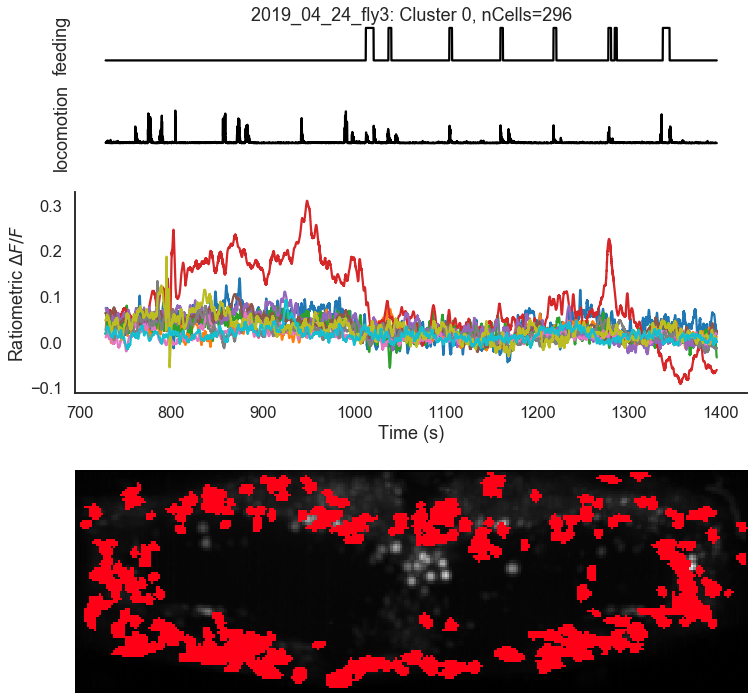

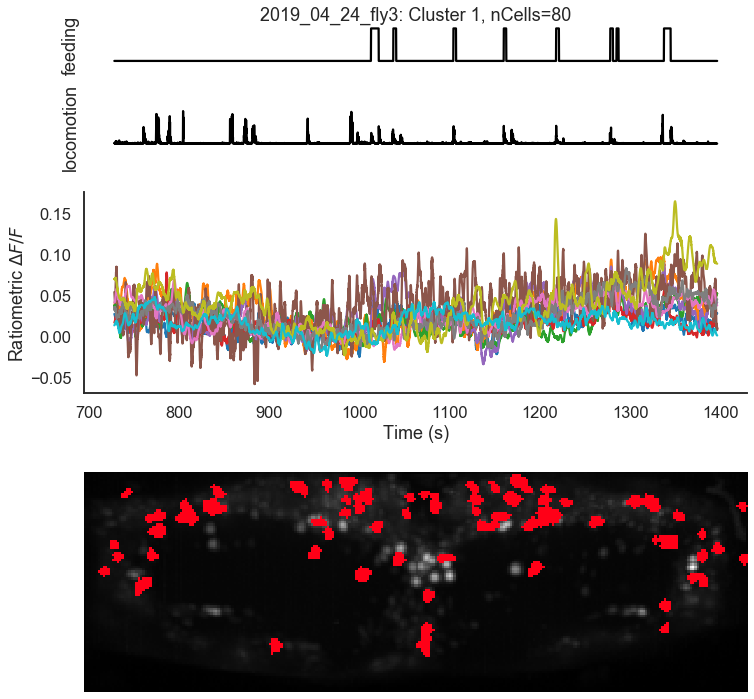

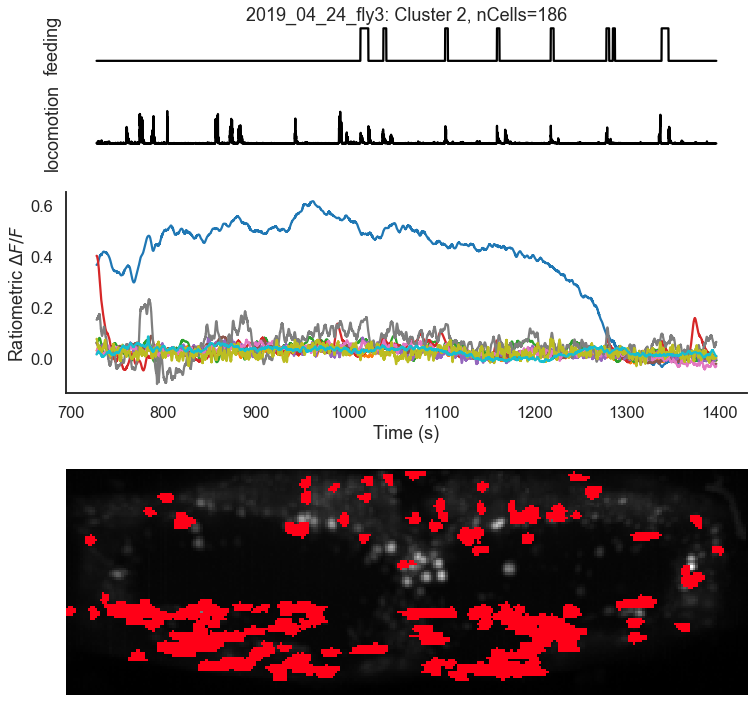

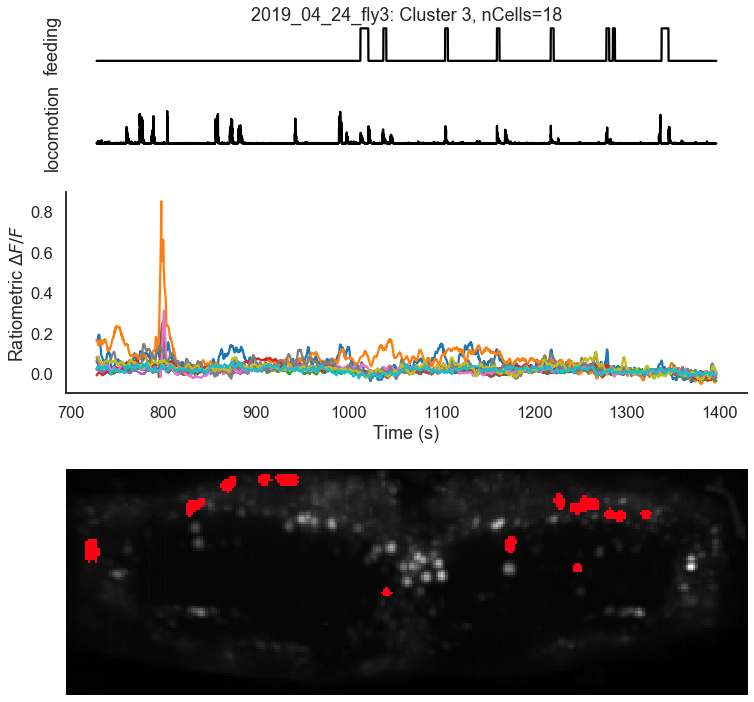

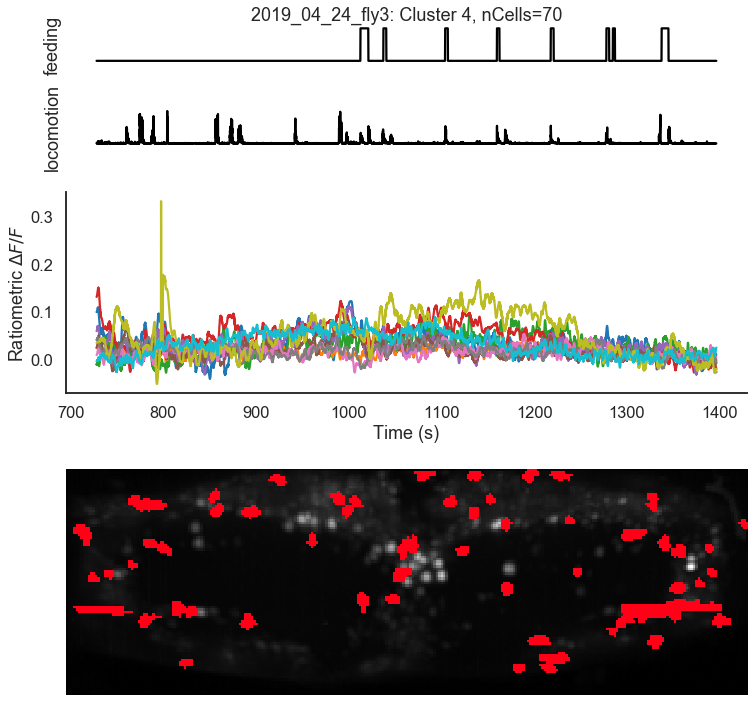

...

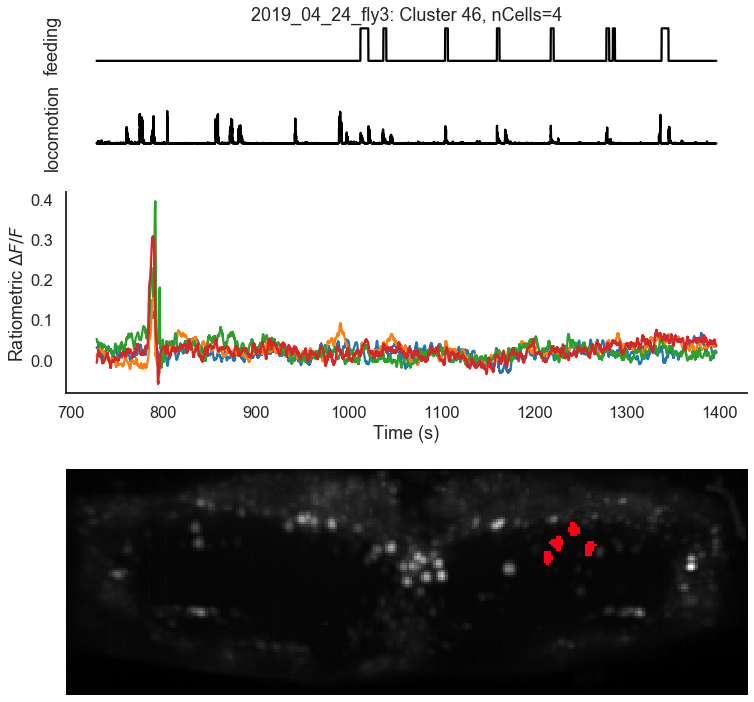

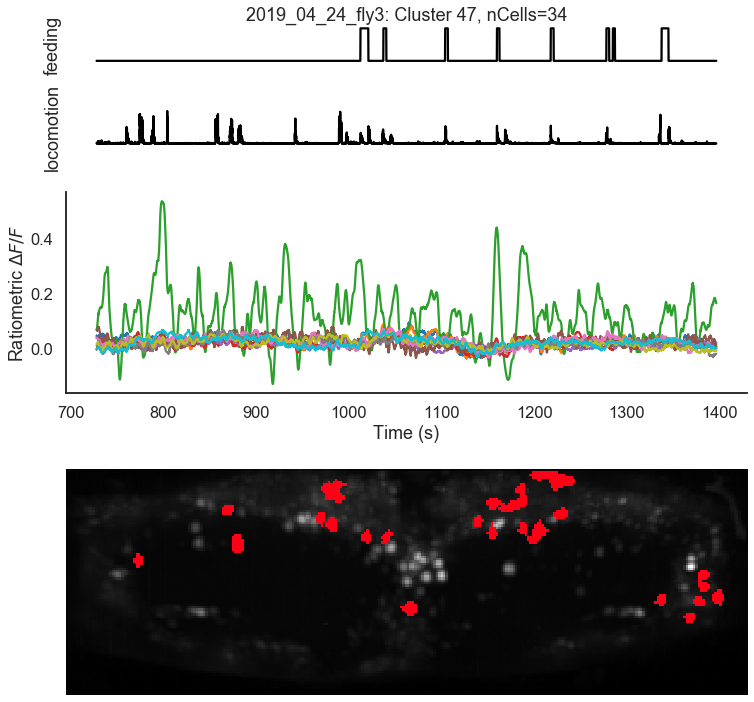

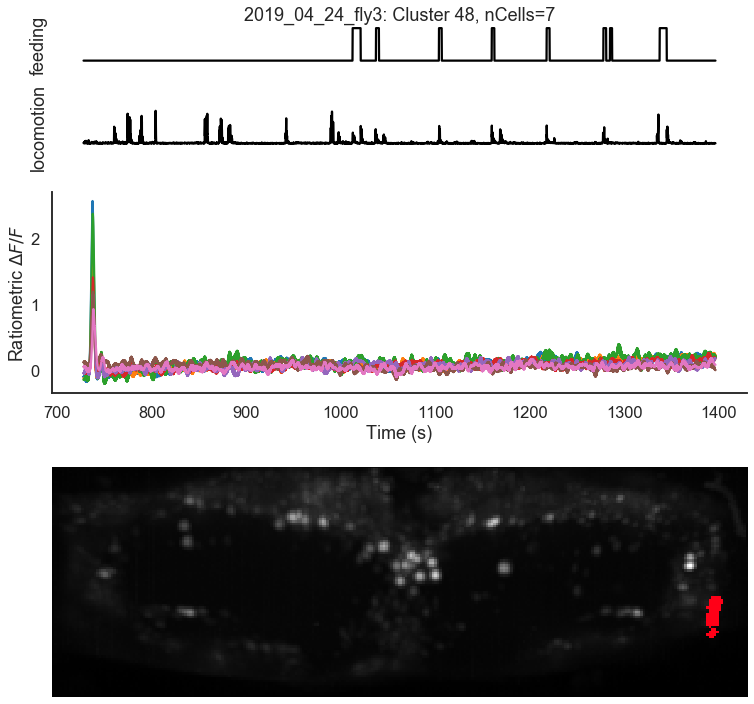

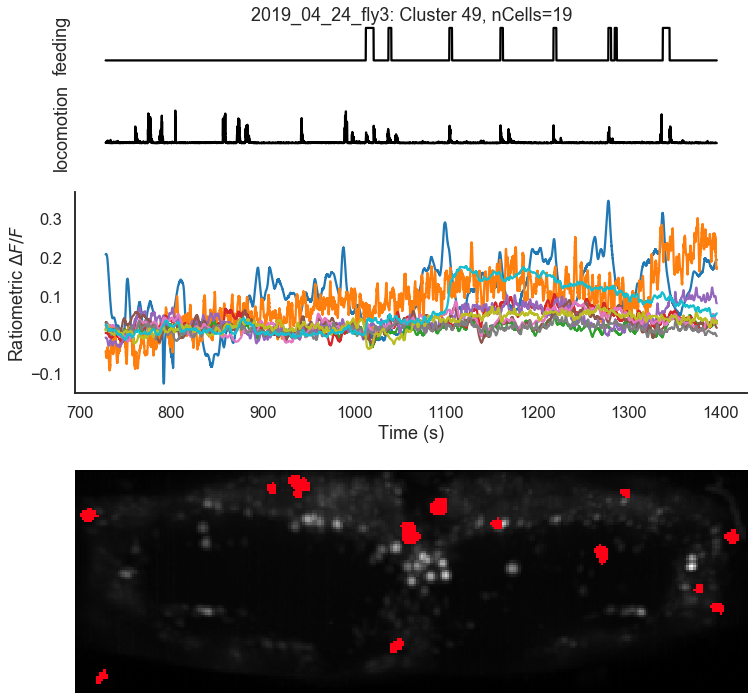

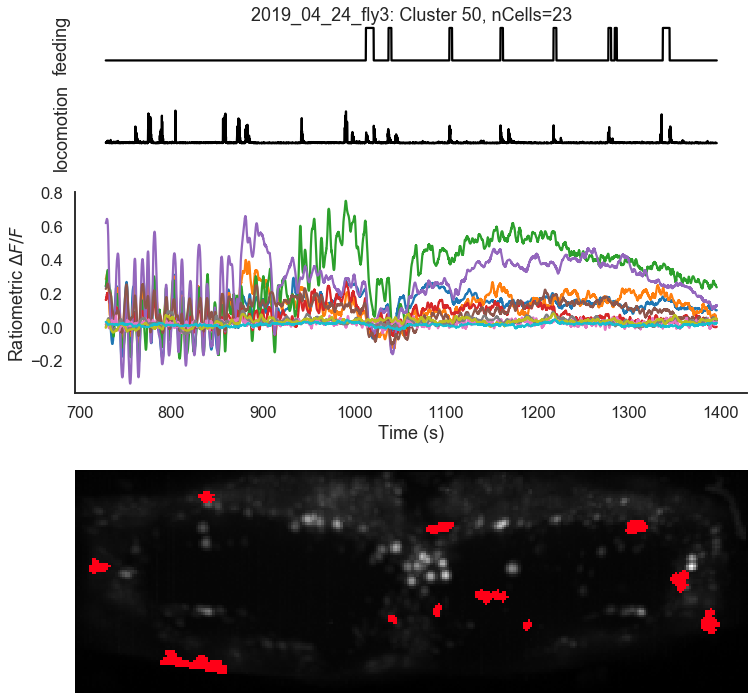

In [14]:
from matplotlib import colors
nToPlot = 10
# dims = [int(i) for i in mat_contents['dims'].T]
# nC = np.shape(A)[1]

for k in range(nClust):
    cIds = [i for i,j in enumerate(cluster.labels_) if j==k]
    plotting.make_clust_fig(k, cIds, data_dict, expt_id=expt_id, nToPlot=10, include_feeding=True)
    plt.savefig(clustfig_folder+expt_id+'_clust_'+str(k)+'.pdf',transparent=True, bbox_inches='tight')
    plt.show()


indices of cells in this cluster:
[41, 73, 76, 89, 103, 140, 204, 206, 215, 216, 221, 235, 260, 273, 307, 308, 371, 431, 441, 454, 471, 490, 491, 497, 519, 579, 586, 621, 635, 643, 678, 689, 700, 768, 804, 910, 948, 973, 1088, 1142, 1223, 1248, 1259, 1281, 1355, 1490, 1521, 1548, 1607, 1610, 1618, 1627, 1636, 1713, 1716, 1757, 1802, 1997, 2018, 2122, 2138, 2139, 2167]


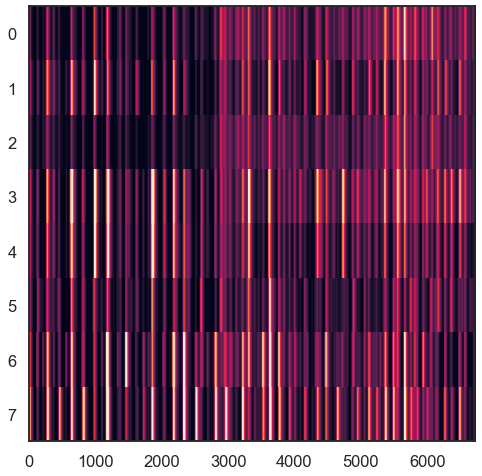

In [47]:
# if needed, manually explore a cluster
clust_id_to_explore = 21
plotlist = [18,16,21,7,12,2,3,6]

cIds = [i for i,j in enumerate(cluster.labels_) if j==clust_id_to_explore]
print('indices of cells in this cluster:')
print(cIds)
plt.figure(figsize=(8,8))
plt.imshow(data_dict['dFF'][np.array(cIds)[plotlist],:],aspect='auto')
plt.show()

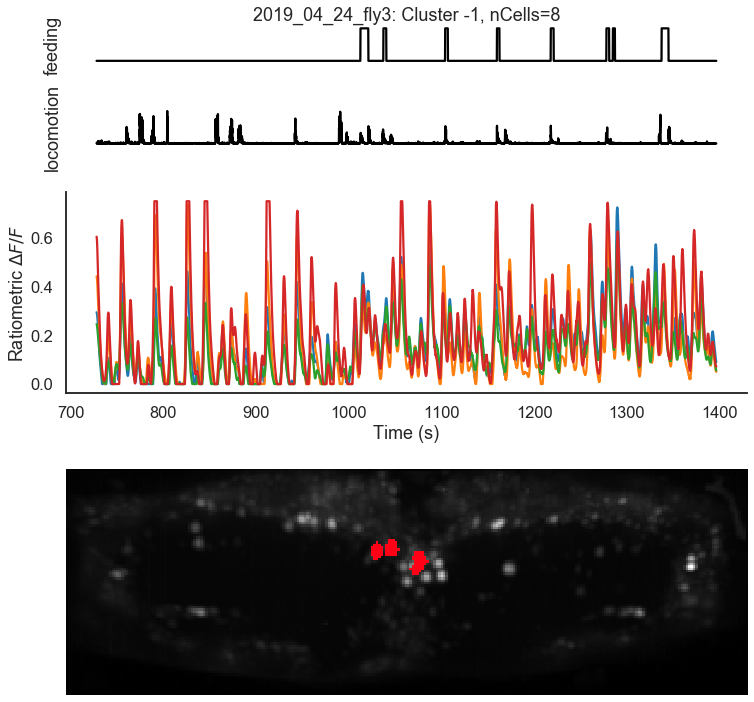

In [49]:
from matplotlib import colors
k=-1
plt_ids=np.array(cIds)[plotlist]

data_dict_scaled = data_dict.copy()
plot_cells = data_dict['dFF'][plt_ids,:]
plot_cells[plot_cells<0]=0
plot_cells[plot_cells>0.75]=0.75
data_dict['dFF'][plt_ids,:] = plot_cells

R = plotting.make_clust_fig(k, plt_ids, data_dict_scaled, expt_id=expt_id, nToPlot=4, include_feeding=True);
plt.savefig(clustfig_folder+expt_id+'_clust_'+str(k)+'.pdf',transparent=True, bbox_inches='tight')
plt.show()
    

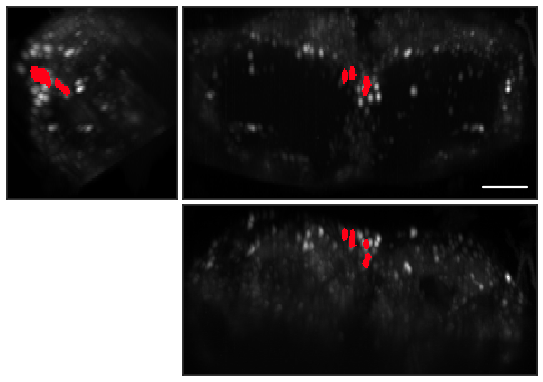

In [51]:
# show cluster footprint in correct scale
ttl='-1'
plotting.show_colorCoded_cellMap(R, [], [0,1], data_dict, cmap=plt.cm.hsv) #bwr
plt.savefig(clustfig_folder+expt_id+'_clust_'+ttl+'_ROIs.pdf',transparent=True, bbox_inches='tight')
plt.show()

# Analysis of time constants relating dFF to FEEDING behavior

In [96]:
## only look at first running trial
data_dict_tr1 = data_dict.copy()
data_dict_tr1['dFF'] = data_dict_tr1['dFF'][:,np.flatnonzero(data_dict['trialFlag']==2)]
data_dict_tr1['ball'] = np.squeeze(data_dict_tr1['drink'][np.flatnonzero(data_dict_tr1['trialFlag']==2)])
data_dict_tr1['time'] = data_dict_tr1['time'][np.flatnonzero(data_dict_tr1['trialFlag']==2)]


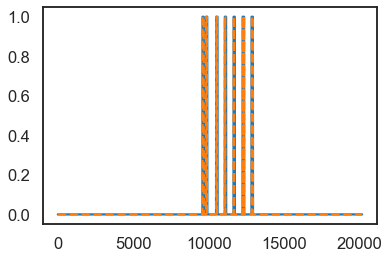

In [110]:
plt.plot(data_dict_tr1['stim'])
plt.plot(data_dict_tr1['drink'],'--')

In [98]:
# find optimal time constant PER NEURON with which to filter ball trace to maximize correlation
tauList, corrMat = dataUtils.estimate_neuron_behav_tau(data_dict_tr1)

/Users/evan/anaconda/envs/flygenvectors/lib/python3.6/site-packages/numpy/lib/function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/Users/evan/anaconda/envs/flygenvectors/lib/python3.6/site-packages/numpy/lib/function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


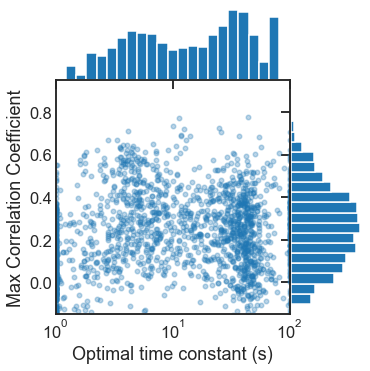

In [99]:
plotting.show_tau_scatter(tauList, corrMat, data_dict_tr1)
plt.savefig(fig_folder + exp_date + '_' + fly_num +'_tauScatter.pdf',transparent=True, bbox_inches='tight')
plt.show()

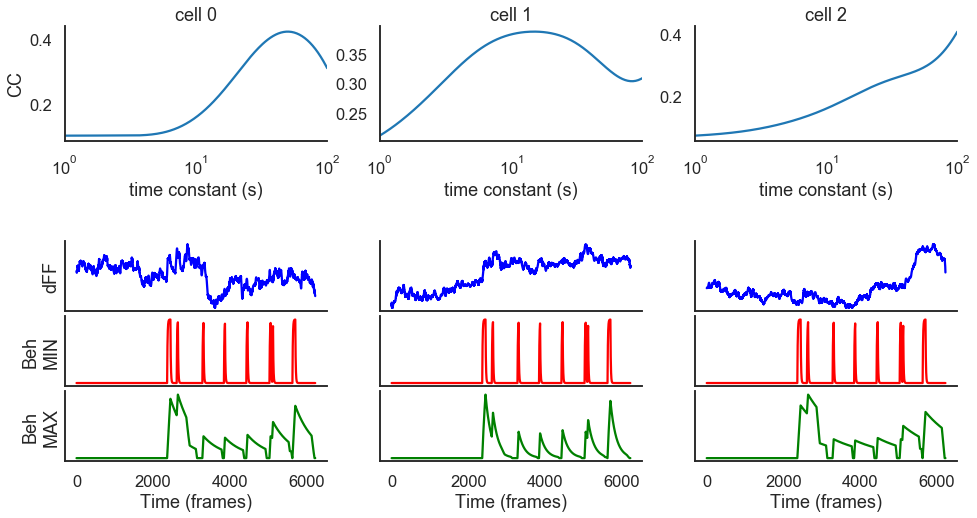

In [100]:
# show example cells
cell_ids = [0,50,250]
plotting.show_example_cells_bestTau(cell_ids, corrMat, tauList, data_dict_tr1)
plt.savefig(fig_folder + exp_date + '_' + fly_num +'_tauSamples.pdf',transparent=True, bbox_inches='tight')
plt.show()

In [101]:
# make brain volume with cells color coded by tau
clrs = len(tauList)
tau_argmax = np.argmax(corrMat,axis=1)
R, mask_vol = plotting.make_colorCoded_cellMap(tau_argmax, clrs, data_dict_tr1)

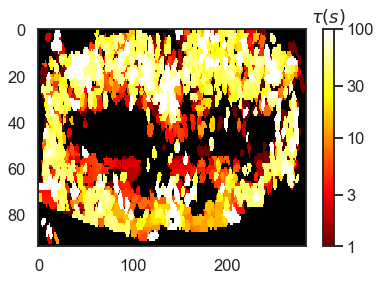

In [102]:
# make COLORBAR for 'brain volume with cells color coded by tau
fullList=tauList/data_dict['scanRate']
tau_label_list=[1,3,10,30,100]
tau_loc_list = plotting.make_labels_for_colorbar(tau_label_list, fullList)
plotting.make_colorBar_for_colorCoded_cellMap(R, mask_vol, tauList, tau_label_list, tau_loc_list, data_dict_tr1)
plt.savefig(fig_folder + exp_date + '_' + fly_num +'_tauMap_colorbar.pdf',transparent=True, bbox_inches='tight')
plt.show()

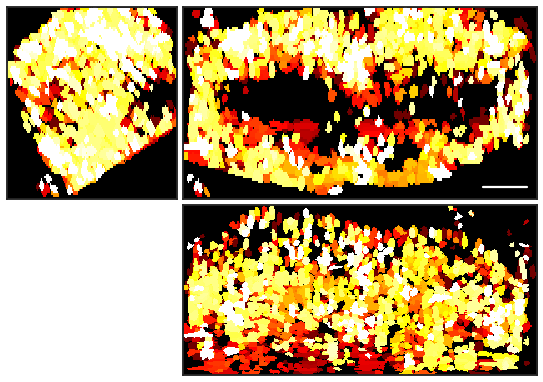

In [103]:
# show brain volume with cells color coded by tau
# in correct spatial dims (bar=50um), color matches above (in secs)
plotting.show_colorCoded_cellMap(R, mask_vol, tau_loc_list[[0,-1]], data_dict_tr1)
plt.savefig(fig_folder + exp_date + '_' + fly_num +'_tauMap.pdf',transparent=True, bbox_inches='tight')
plt.show()

In [104]:
# show location of 'slow' cells, color coded by CC
cbounds = (-1, 1) # corr from -1 to 1
tau_valmax = np.max(corrMat,axis=1) # color by max cc instead of argmax as above
S, mask_vol = plotting.make_colorCoded_cellMap(tau_valmax, clrs, data_dict_tr1, cbounds)

../../flygenvectors/plotting.py:805: RuntimeWarning: invalid value encountered in greater
  cli = np.flatnonzero(  (feature_vec>c_space[j]) & (feature_vec<c_space[j+1])  )
../../flygenvectors/plotting.py:805: RuntimeWarning: invalid value encountered in less
  cli = np.flatnonzero(  (feature_vec>c_space[j]) & (feature_vec<c_space[j+1])  )


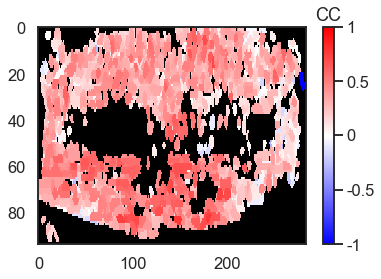

In [105]:
# make COLORBAR for 'brain volume with cells color coded by CC
cmap = 'bwr'
ccList=np.linspace(-1.0, 1.0, num=len(tauList))
label_list=[-1,-0.5,0,0.5,1]
cc_loc_list = plotting.make_labels_for_colorbar(label_list, ccList)
plotting.make_colorBar_for_colorCoded_cellMap(S, mask_vol, ccList, label_list, cc_loc_list, data_dict_tr1, cmap)
plt.savefig(fig_folder + exp_date + '_' + fly_num +'_ccMap_colorbar.pdf',transparent=True, bbox_inches='tight')
plt.show()

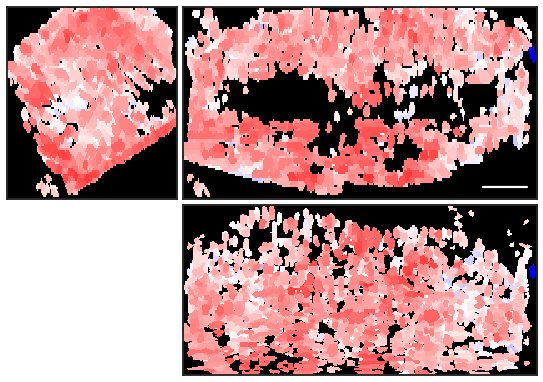

In [106]:
# show brain volume with cells color coded by max CC
# in correct spatial dims (bar=50um), color from CC=-1 to CC=1
plotting.show_colorCoded_cellMap(S, mask_vol, tau_loc_list[[0,-1]], data_dict_tr1, cmap)
plt.savefig(fig_folder + exp_date + '_' + fly_num +'_ccMap.pdf',transparent=True, bbox_inches='tight')
plt.show()